In [1]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import numpy as np
import numpy as np
sc.set_figure_params(dpi=100, dpi_save=300, frameon=False, )
import shutup; shutup.please()
import anndata as ad
sc.set_figure_params(fontsize=8, frameon=False)

In [2]:
pwd

'/home/aih/shrey.parikh/PDAC/PDAC/final_code'

In [3]:
scpoli_dataset = sc.read_h5ad('/home/aih/shrey.parikh/PDAC/PDAC/scIB_metrics_toolbox/datasets_metrics/scPoli/scPoli_dataset_reference_latent_label_transfer_metrics.h5ad')

In [4]:
scpoli_donor = sc.read_h5ad('/home/aih/shrey.parikh/PDAC/PDAC/scIB_metrics_toolbox/datasets_metrics/scPoli/scPoli_donor_reference_latent_label_transfer_metrics.h5ad')

In [5]:
scanvi = sc.read_h5ad('/home/aih/shrey.parikh/PDAC/PDAC/scIB_metrics_toolbox/datasets_metrics/scANVI/scanvae_dataset_full_latent_metrics.h5ad')  

# scpoli

In [9]:
scpoli = [scpoli_dataset, scpoli_donor]

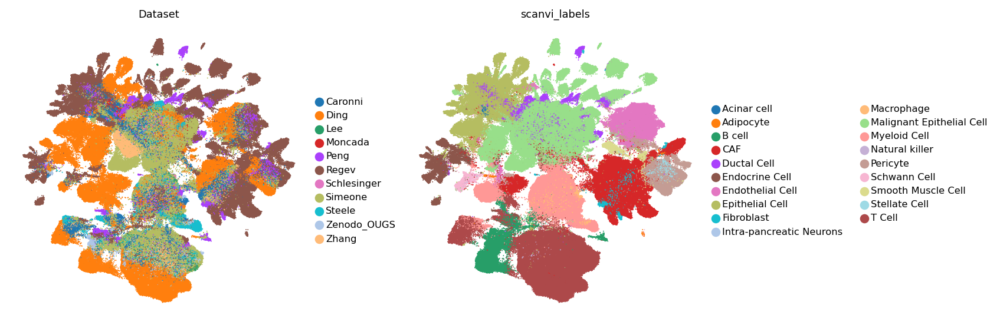

In [20]:
random_indices=np.random.permutation(list(range(scanvi.shape[0])))
sc.pl.umap(scanvi[random_indices,:], color=['Dataset', 'scanvi_labels'], size=3, frameon=False)

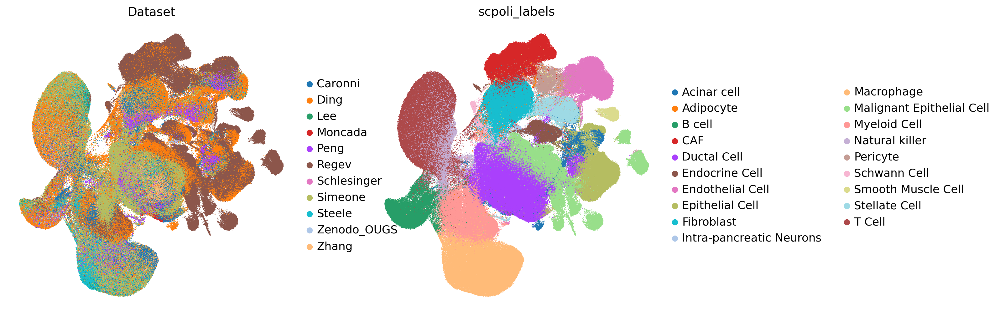

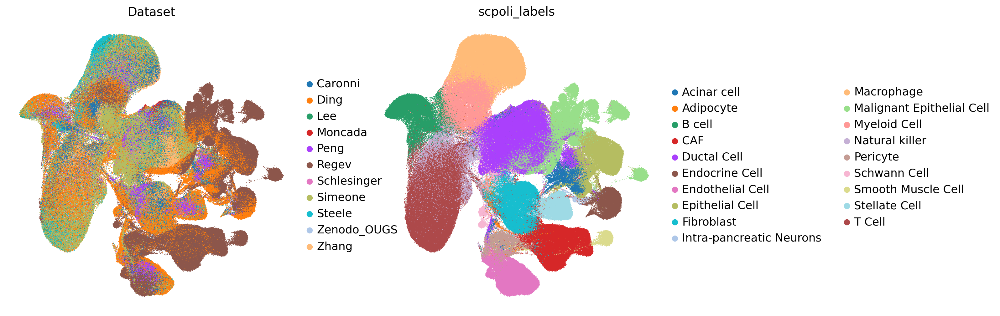

In [11]:
for adata in scpoli:
    adata.obsm['X_umap'] = adata.obsm['X_umap_emb']
    plt.rcParams['figure.figsize'] = (6,6)
    random_indices=np.random.permutation(list(range(adata.shape[0])))
    sc.pl.umap(adata[random_indices,:], color=['Dataset', 'scpoli_labels'], size=3, frameon=False)

In [9]:
cell_type_markers = {
    'Myeloid Cell': ['CD14', 'CD11b', 'CD68', 'CD45'],
    'Epithelial Cell': ['EPCAM', 'KRT19', 'CDH1'],
    'CAF (Cancer-Associated Fibroblast)': ['FAP', 'ACTA2', 'PDGFRB'],
    'Ductal Cell': ['KRT7', 'SOX9', 'KRT19'],
    'Malignant Epithelial Cell': ['TP53', 'SMAD4', 'KRAS', 'CDKN2A', 'NOTCH1','KRT5', 'KRT19'],
    'Pericyte': ['PDGFRB', 'RGS5', 'CD146'],
    'Smooth Muscle Cell': ['ACTA2', 'MYH11', 'TAGLN'],
    'T Cell': ['CD3D', 'CD3E', 'CD8A'],  # For CD8 T cells, or use 'CD4' for helper T cells
    'Endothelial Cell': ['PECAM1', 'VWF', 'CDH5'],
    'Endocrine Cell': ['CHGA', 'SYP', 'INS', 'GCG', 'SST'],  # 'INS' for insulin (beta cells)
    'B cell': ['CD19', 'CD20', 'MS4A1']
}

In [7]:
def marker_selection(adata, cell_type_markers, detected_markers=[], titles=[]):
    for cell_type, markers in cell_type_markers.items():
        for marker in markers:
            if marker in adata.var_names:
                detected_markers.append(marker)
                titles.append(f"{marker} expression in {cell_type}")
    return detected_markers, titles

In [ ]:
detected_markers = []
titles = []
marker_selection(scpoli_dataset, cell_type_markers, detected_markers, titles)

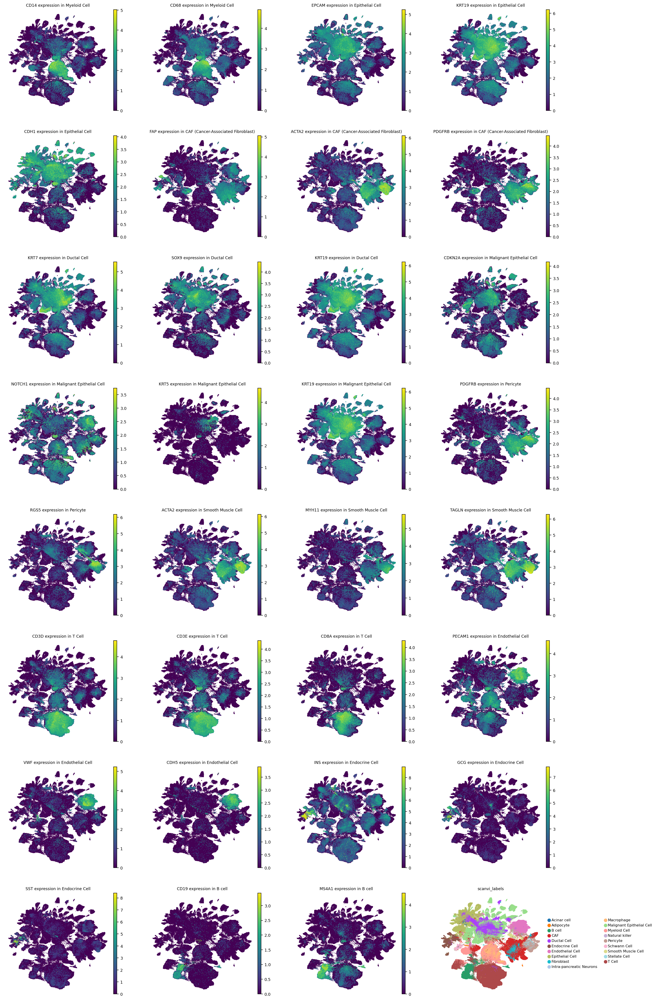

In [31]:
detected_markers = []
titles = []
marker_selection(scanvi, cell_type_markers, detected_markers, titles)
detected_markers.append('scanvi_labels')
if 'X_umap_emb' not in scanvi.obsm:
    print('no')
else:
    scanvi.obsm['X_umap'] = scanvi.obsm['X_umap_emb']
    
sc.pl.umap(scanvi, color=detected_markers, size=3,title=titles, frameon=False, save='scanvi_labels.png')

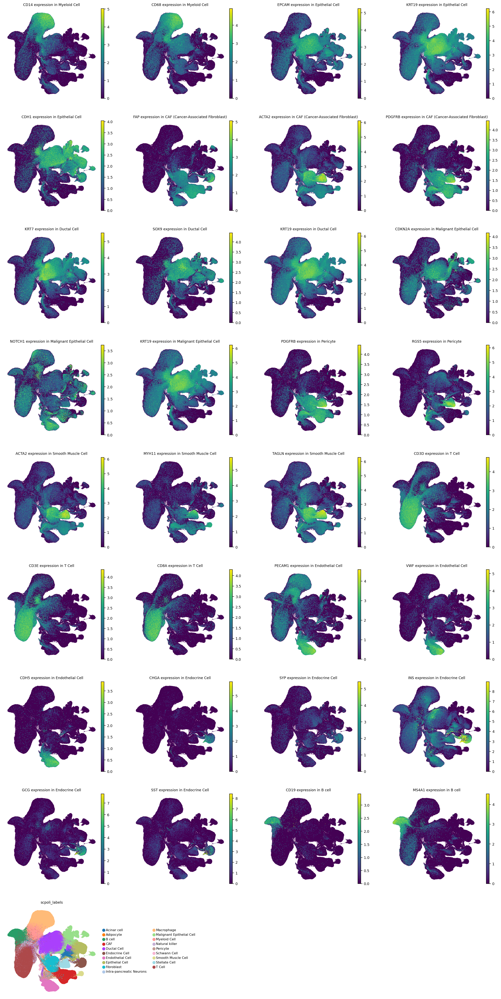

In [32]:
detected_markers = []
titles = []
marker_selection(scpoli_donor, cell_type_markers, detected_markers, titles)
detected_markers.append('scpoli_labels')
scpoli_donor.obsm['X_umap'] = scpoli_donor.obsm['X_umap_emb']
sc.pl.umap(scpoli_donor, color=detected_markers, size=3,title=titles, frameon=False, save='scpoli_donor.png')

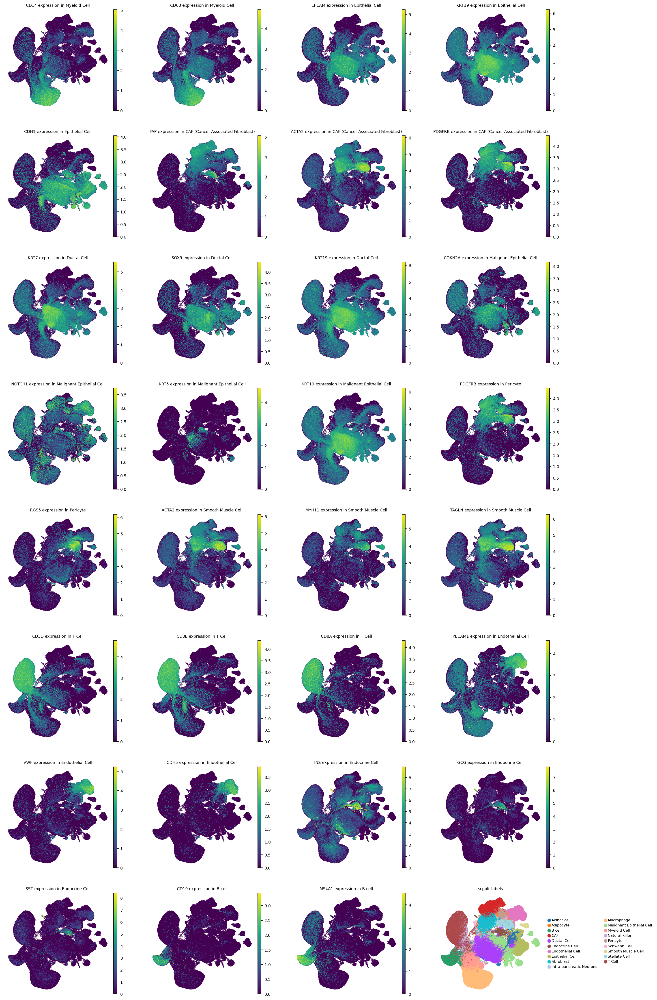

In [33]:
detected_markers = []
titles = []
marker_selection(scpoli_dataset, cell_type_markers, detected_markers, titles)
detected_markers.append('scpoli_labels')
scpoli_dataset.obsm['X_umap'] = scpoli_dataset.obsm['X_umap_emb']
sc.pl.umap(scpoli_dataset, color=detected_markers, size=3,title=titles, frameon=False, save='scpoli_dataset.png')